# Capstone project 1: Pet Product Auto-Subcategorization by Review Analysis

**Goal: Creating a system that automatically classifies products in Pet Supplies category into subcategories by analyzing the reviews.**  
In this project, the data collected during 2014 - 2015 in the US is used.

## 1. Loading Data

In [1]:
%matplotlib notebook

import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
import nltk
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
from sklearn.feature_extraction.text import TfidfVectorizer

In [2]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle the code on/off."></form>''')

The dataset is available on https://s3.amazonaws.com/amazon-reviews-pds/tsv/amazon_reviews_us_Pet_Products_v1_00.tsv.gz

In [3]:
# Load the tsv file with columns which will be used
data = pd.read_table('amazon_reviews_us_Pet_Products_v1_00.tsv', usecols=[0,4,5,6,13,14])
data.head()

,marketplace,product_parent,product_title,product_category,review_body,review_date
0,US,510387886,(8-Pack) EZwhelp Belly Band/Wrap,Pet Products,Best belly bands on the market! These are a g...,2015-08-31
1,US,912374672,Warren Eckstein's Hugs & Kisses Vitamin Minera...,Pet Products,"My dogs love Hugs and Kisses. However, the la...",2015-08-31
2,US,902215727,Tyson's True Chews Premium Jerky - 12 ounce Ch...,Pet Products,I have been purchasing these for a long time. ...,2015-08-31
3,US,568880110,"Soft Side Pet Crate, Navy/Tan",Pet Products,"It is extremely well constructed, it is easy t...",2015-08-31
4,US,692846826,"EliteField 3-Door Folding Soft Dog Crate, Indo...",Pet Products,Worked really well. Very pleased with my purc...,2015-08-31


In [4]:
# Change the clomun label from 'product_parent' to 'product_id'
data = data.rename(columns={'product_parent':'product_id'})
data.head()

,marketplace,product_id,product_title,product_category,review_body,review_date
0,US,510387886,(8-Pack) EZwhelp Belly Band/Wrap,Pet Products,Best belly bands on the market! These are a g...,2015-08-31
1,US,912374672,Warren Eckstein's Hugs & Kisses Vitamin Minera...,Pet Products,"My dogs love Hugs and Kisses. However, the la...",2015-08-31
2,US,902215727,Tyson's True Chews Premium Jerky - 12 ounce Ch...,Pet Products,I have been purchasing these for a long time. ...,2015-08-31
3,US,568880110,"Soft Side Pet Crate, Navy/Tan",Pet Products,"It is extremely well constructed, it is easy t...",2015-08-31
4,US,692846826,"EliteField 3-Door Folding Soft Dog Crate, Indo...",Pet Products,Worked really well. Very pleased with my purc...,2015-08-31


In [5]:
# Check the general information
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2639981 entries, 0 to 2639980
Data columns (total 6 columns):
marketplace         object
product_id          int64
product_title       object
product_category    object
review_body         object
review_date         object
dtypes: int64(1), object(5)
memory usage: 120.8+ MB


In [6]:
# Is there any missing date?: Yes
data.isnull().any(axis=0)

marketplace         False
product_id          False
product_title        True
product_category    False
review_body          True
review_date          True
dtype: bool

## 2. Data Wrangling

#### Approach:

2.1. Extracting data collected in 2014 or 2015  
2.2. Removing columns having a single value  
2.3. Dealing with missing values and duplicate data  
2.4. Removing products having only one review  
2.5. Adjusting the number of reviews per product  
2.6. Merging reviews to the same product in one  
2.7. Tokenization  
2.8. Retaining only alphabets  
2.9. Removing stop words  
2.10. Stemming  
2.11. Retaining only nouns  
2.12. Removing words appearing only once or twice 

### 2.1. Extracting data collected in 2014 or 2015

In [7]:
# Extract data in 2015 (ignore data without a date label)
df_2015 = data[data['review_date'].str.contains('2015-', na=False)] 
df_2015.head()

,marketplace,product_id,product_title,product_category,review_body,review_date
0,US,510387886,(8-Pack) EZwhelp Belly Band/Wrap,Pet Products,Best belly bands on the market! These are a g...,2015-08-31
1,US,912374672,Warren Eckstein's Hugs & Kisses Vitamin Minera...,Pet Products,"My dogs love Hugs and Kisses. However, the la...",2015-08-31
2,US,902215727,Tyson's True Chews Premium Jerky - 12 ounce Ch...,Pet Products,I have been purchasing these for a long time. ...,2015-08-31
3,US,568880110,"Soft Side Pet Crate, Navy/Tan",Pet Products,"It is extremely well constructed, it is easy t...",2015-08-31
4,US,692846826,"EliteField 3-Door Folding Soft Dog Crate, Indo...",Pet Products,Worked really well. Very pleased with my purc...,2015-08-31


In [8]:
# Check the number of the rows
len(df_2015)

875524

In [9]:
# Extract data in 2014 (ignore data without a date label)
df_2014 = data[data['review_date'].str.contains('2014-', na=False)] 
df_2014.head()

,marketplace,product_id,product_title,product_category,review_body,review_date
875589,US,384773221,Flea Control Killer 12 Monthly Capsules of Luf...,Pet Products,Been working good so far.,2014-12-31
875590,US,226765263,Four Paws Wee-Wee Pet Training and Puppy Pads,Pet Products,"Great pads, they work great! Also great value,...",2014-12-31
875591,US,698924655,Cockatiel Nutri-Berries,Pet Products,Got here faster loved it & my Quaker parrots L...,2014-12-31
875592,US,456586629,Willow Branch Ball for Small Animals,Pet Products,"Bunny likes it, but I'd like it to last longer.",2014-12-31
875593,US,438365490,Rubies Costume Rubies Princess Pet Costume,Pet Products,Too small for my german shepherd,2014-12-31


In [10]:
# Check the number of the rows
len(df_2014)

829705

In [11]:
# Merge the two dataframes
df_two_years = df_2015.append(df_2014)
df_two_years.head()

,marketplace,product_id,product_title,product_category,review_body,review_date
0,US,510387886,(8-Pack) EZwhelp Belly Band/Wrap,Pet Products,Best belly bands on the market! These are a g...,2015-08-31
1,US,912374672,Warren Eckstein's Hugs & Kisses Vitamin Minera...,Pet Products,"My dogs love Hugs and Kisses. However, the la...",2015-08-31
2,US,902215727,Tyson's True Chews Premium Jerky - 12 ounce Ch...,Pet Products,I have been purchasing these for a long time. ...,2015-08-31
3,US,568880110,"Soft Side Pet Crate, Navy/Tan",Pet Products,"It is extremely well constructed, it is easy t...",2015-08-31
4,US,692846826,"EliteField 3-Door Folding Soft Dog Crate, Indo...",Pet Products,Worked really well. Very pleased with my purc...,2015-08-31


In [12]:
# Count the number of the rows
len(df_two_years)

1705229

### 2.2. Removing columns having a single value

In [13]:
# Check if all 'marketplace' vlaues are 'US'
print(len(df_two_years[df_two_years['marketplace'] != 'US']))

# Check if all 'product_category' values are 'Pet Products'
print(len(df_two_years[df_two_years['product_category'] != 'Pet Products']))

0
0


There is no incorrect value. 

In [14]:
# Remove the two columns and 'review_date' column
df = df_two_years[['product_id', 'product_title', 'review_body']]
df.head()

,product_id,product_title,review_body
0,510387886,(8-Pack) EZwhelp Belly Band/Wrap,Best belly bands on the market! These are a g...
1,912374672,Warren Eckstein's Hugs & Kisses Vitamin Minera...,"My dogs love Hugs and Kisses. However, the la..."
2,902215727,Tyson's True Chews Premium Jerky - 12 ounce Ch...,I have been purchasing these for a long time. ...
3,568880110,"Soft Side Pet Crate, Navy/Tan","It is extremely well constructed, it is easy t..."
4,692846826,"EliteField 3-Door Folding Soft Dog Crate, Indo...",Worked really well. Very pleased with my purc...


### 2.3. Dealing with missing values and duplicate data

#### 2.3.1. Removing missing values

In [15]:
# How many products in df?
df['product_id'].nunique()

128995

In [16]:
# Is there any missing date?
df.isnull().sum()

product_id         0
product_title      0
review_body      216
dtype: int64

In [17]:
# If droping the rows having null, how many products will be removed?
df_dropna = df.dropna(how='any')
df['product_id'].nunique() - df_dropna['product_id'].nunique()

18

I have decided to remove these products from this model because a product without a review is not an active pruduct.  
The products are shown as a list for later.

In [18]:
# Extrct the products' names
before = df[['product_id', 'product_title']].drop_duplicates()
after = df_dropna[['product_id', 'product_title']].drop_duplicates()
null_reviews = before[~before['product_id'].isin(after['product_id'])]

# Set the index to 'product_id' column
null_reviews = null_reviews.set_index(['product_id']).sort_index()

# Show the list
print(null_reviews)

,product_title
product_id,
59503872,{Factory Direct Sale} 100Pcs Set Poultry Leg B...
111888120,"Genuine Leather Dog Harness, Medium. 25.5""-29""..."
173421502,Dean & Tyler 26 to 37-Inch Strong Nylon Cobra ...
194817456,Generic New Pet Dog Cat Leather Spike Stud Col...
299399624,Mirage Pet Bitches Love Me Screen Print Dog Ba...
404027221,Mosunx(TM) Hot Pet Dog Puppy Tutu Princess Dre...
418434105,Saddle Bag Pet Dogs Backpack Travel Hiking Har...
490871023,"Casual Canine Reindeer Hoodie for Dogs, 10"" XS..."
507641146,San Francisco Bay Brand Herp Instant Meal Turt...


Table1. No review products list

#### 2.3.2. Removing duplicate data

In [19]:
# Remove duplicate data: 8004 duplicate data
df_drop_dup = df_dropna.drop_duplicates()
len(df) - len(df_drop_dup)

8004

In [20]:
# Show the number of reviews in df_drop_dup
len(df_drop_dup)

1697225

In [21]:
# Show the number of products in df_drop_dup
df_drop_dup['product_id'].nunique()

128977

### 2.4. Removing products having only one review

I have decided to remove products having only one review because it would be difficult to find common words with other products by using the only one review, also one review would mean not so active as a product.

In [22]:
# Recheck df_drop_dup
df_drop_dup.head()

,product_id,product_title,review_body
0,510387886,(8-Pack) EZwhelp Belly Band/Wrap,Best belly bands on the market! These are a g...
1,912374672,Warren Eckstein's Hugs & Kisses Vitamin Minera...,"My dogs love Hugs and Kisses. However, the la..."
2,902215727,Tyson's True Chews Premium Jerky - 12 ounce Ch...,I have been purchasing these for a long time. ...
3,568880110,"Soft Side Pet Crate, Navy/Tan","It is extremely well constructed, it is easy t..."
4,692846826,"EliteField 3-Door Folding Soft Dog Crate, Indo...",Worked really well. Very pleased with my purc...


In [50]:
# Group by 'product_id' and count the number of reviews for each product
df_count_by_product = df_drop_dup[['product_id', 'review_body']].groupby('product_id').count()

# Change the column label
df_count_by_product.columns = ['number_of_reviews']

<IPython.core.display.Javascript object>


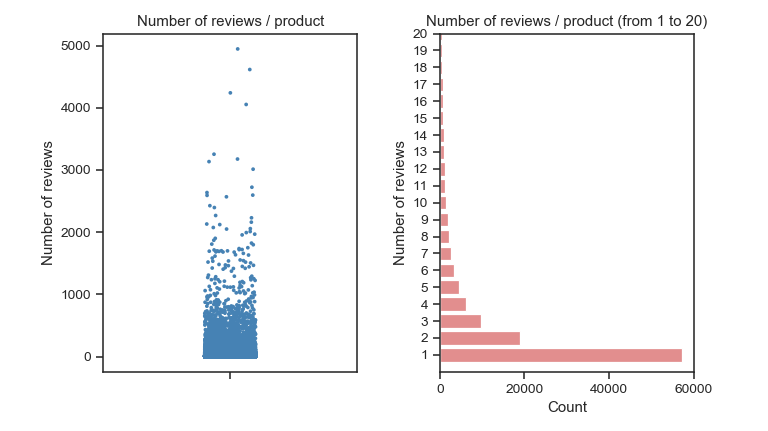

In [438]:
# Draw a strip plot and a count plot
sns.set(context='notebook', style='ticks', palette='hls')
plt.figure()

plt.subplot(1,2,1)
sns.stripplot(y='number_of_reviews', data=df_count_by_product, size=3, color='steelblue', jitter=True)
plt.ylabel('Number of reviews')
plt.title('Number of reviews / product')

plt.subplot(1,2,2)
sns.countplot(y='number_of_reviews', data=df_count_by_product, color='lightcoral')
plt.ylim([-1,19])
plt.xlabel('Count')
plt.ylabel('Number of reviews')
plt.title('Number of reviews / product (from 1 to 20)')

plt.tight_layout()
plt.show()

There are many products having only one review.

In [56]:
# Count of the number of products having only one review
df_count_1 = df_count_by_product[df_count_by_product['number_of_reviews'] == 1]
df_count_1.count()

number_of_reviews    57248
dtype: int64

In [61]:
# Set the index to 'product_id' to drop rows by index, and drop rows which products have one review
df_more1 = df_drop_dup.set_index(['product_id']).sort_index().drop(df_count_1.index)
df_more1.head()

,product_title,review_body
product_id,,
3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Very soft warm material . Very large for a 3 p...
3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Ordered an xs and got a small. So obviously it...
3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Best Coat a dog can have. Very well made
8072,YML Lot of 12 Clear Plastic Cup for Breeding C...,"great value bulk pack,they fit inside most sta..."
8072,YML Lot of 12 Clear Plastic Cup for Breeding C...,100% satisfied.


In [62]:
# Check the distribution after removing reviews having one review
df_count_more1 = df_count_by_product[df_count_by_product['number_of_reviews'] != 1]
df_count_more1.describe()

,number_of_reviews
count,71729.000000
mean,22.863514
std,93.198709
min,2.000000
25%,2.000000
50%,5.000000
75%,13.000000
max,4947.000000


Products having only one review were removed.  
The products are shown as a list for later.

In [269]:
# Extrct the products' names
# after = df_dropna[['product_id', 'product_title']].drop_duplicates()
one_reviews = after[~after['product_id'].isin(df_more1.index)] 

# Set the index to 'product_id' column
one_reviews = one_reviews.set_index(['product_id']).sort_index()

# Show the list
one_reviews

                                                product_title
product_id                                                   
13903       Mr Bites 9-Inch Rawhide Retriever Roll for Dog...
53358                           Ivermectin Sheep Drench 8 oz.
72022       Up Country Anchors Aweigh Design - Size Medium...
97110       Bio spot 100504718 Bio Spot Defense Flea & Tic...
98023       Darford Omega Booster Salmon and Mackeral 20 U...
...                                                       ...
999914469                                 Large Cat Play Tree
999930748                 New Earth Soy Adjustable Collar, 1"
999931715                      Hand Puppet Dog Toy--ALLIGATOR
999977146          Max's Closet 30413-M Red Solid Fancy Pants
999991235   You Are Beautiful Believe In Yourself Dog Tag ...

[57248 rows x 1 columns]


Table2. One review products list

### 2.5. Adjusting the number of reviews per product

The number of reviews per product is adjusted to be two to five to make this model efficient.

In [64]:
# Count the number of products having equal to or greater than 6 reviews
df_count_more5 = df_count_by_product[df_count_by_product['number_of_reviews'] >= 6]
df_count_more5.count()

number_of_reviews    32290
dtype: int64

In [65]:
# Extract rows which products have 2 to 5 reviews
df_2to5 = df_more1.drop(df_count_more5.index)
df_2to5.head()

,product_title,review_body
product_id,,
3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Very soft warm material . Very large for a 3 p...
3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Ordered an xs and got a small. So obviously it...
3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Best Coat a dog can have. Very well made
8072,YML Lot of 12 Clear Plastic Cup for Breeding C...,"great value bulk pack,they fit inside most sta..."
8072,YML Lot of 12 Clear Plastic Cup for Breeding C...,100% satisfied.


In [66]:
# Extract products having 2 to 5 reviews to get rows which products have equal to or greater than 6 reviews 
df_count_2to5 = df_count_more1[df_count_more1['number_of_reviews'] <= 6]

# Get rows which products have equal to or greater than 6 reviews 
df_more5 = df_more1.drop(df_count_2to5.index)
df_more5.head(10)

,product_title,review_body
product_id,,
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",After losing several collars during her outdoo...
17464,"Beastie Bands ZEBRA Cat Collar, Stripes","Safe, looks great, easily adjustable, affordab..."
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",This Beastie Band collar was a good buy. It w...
17464,"Beastie Bands ZEBRA Cat Collar, Stripes","Perfect cat collar, have these on all my cats...."
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",These have been great collars for my cats. St...
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",I LOVE these bands for convenience sake. Velc...
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",These are really fabulous. I have a cat that ...
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",I really like the Beastie Bands for my cats. ...
52493,Hartz Groomer's Best Pedicure Kit for Dogs and...,didn't care for the quality of these they are ...


In [68]:
# Group by the index to get 5 reviews per product
df_more5_by_product = df_more5.groupby(level=0)

# Get 5 reviews per product
df_five_reviews = pd.DataFrame()
for product, group in df_more5_by_product:
    df_five_reviews = df_five_reviews.append(group.iloc[:5])
df_five_reviews.head(11)

,product_title,review_body
product_id,,
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",After losing several collars during her outdoo...
17464,"Beastie Bands ZEBRA Cat Collar, Stripes","Safe, looks great, easily adjustable, affordab..."
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",This Beastie Band collar was a good buy. It w...
17464,"Beastie Bands ZEBRA Cat Collar, Stripes","Perfect cat collar, have these on all my cats...."
17464,"Beastie Bands ZEBRA Cat Collar, Stripes",These have been great collars for my cats. St...
52493,Hartz Groomer's Best Pedicure Kit for Dogs and...,didn't care for the quality of these they are ...
52493,Hartz Groomer's Best Pedicure Kit for Dogs and...,i have a bulldog and shes huge and it works gr...
52493,Hartz Groomer's Best Pedicure Kit for Dogs and...,These are better then our old nail clippers. ...
52493,Hartz Groomer's Best Pedicure Kit for Dogs and...,"First of all it wasn't even purple, it was ora..."


In [69]:
# Merge the two dataframes
df_reduced_reviews = df_2to5.append(df_five_reviews)
df_reduced_reviews = df_reduced_reviews.reset_index()
df_reduced_reviews.head()

,product_id,product_title,review_body
0,3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Very soft warm material . Very large for a 3 p...
1,3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Ordered an xs and got a small. So obviously it...
2,3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...,Best Coat a dog can have. Very well made
3,8072,YML Lot of 12 Clear Plastic Cup for Breeding C...,"great value bulk pack,they fit inside most sta..."
4,8072,YML Lot of 12 Clear Plastic Cup for Breeding C...,100% satisfied.


In [70]:
# Group by 'product_id' and count the number of reviews for each product
df_count_by_product_reduced = df_reduced_reviews[['product_id','review_body']].groupby('product_id').count()

# Change the column label
df_count_by_product_reduced.columns = ['number_of_reviews']

# Check the distribution
df_count_by_product_reduced.describe()

,number_of_reviews
count,71729.000000
mean,3.844874
std,1.298683
min,2.000000
25%,2.000000
50%,5.000000
75%,5.000000
max,5.000000


<IPython.core.display.Javascript object>


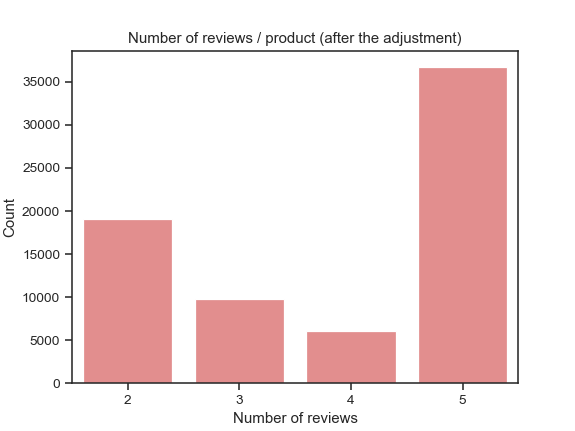

In [436]:
# Show a count plot
plt.figure()
sns.countplot(x='number_of_reviews', data=df_count_by_product_reduced, color='lightcoral')
plt.xlabel('Number of reviews')
plt.ylabel('Count')
plt.title('Number of reviews / product (after the adjustment)')
plt.show()

Now, all products have 2 to 5 reviews.

In [92]:
# Check the number of total reviews in df_reduced_reviews
len(df_reduced_reviews)

275789

In [93]:
# Check the number of products in df_reduced_reviews
df_reduced_reviews['product_id'].nunique()

71729

### 2.6. Merging reviews to the same product in one

In [91]:
# Merging reviews to the same product in one
df_by_product = df_reduced_reviews[['product_id', 'review_body']].groupby('product_id').sum()
df_by_product.head()

,review_body
product_id,
3270,Very soft warm material . Very large for a 3 p...
8072,"great value bulk pack,they fit inside most sta..."
17464,After losing several collars during her outdoo...
19343,"Works very well, rechargeable collar is a big ..."
23478,One of the latching bar's welding broke the in...
...,...
999930798,"Recommended by my vet and approved by my dog, ..."
999944581,i learned of this 'brush' on facebook from ano...
999961811,My kitties are 15 to 20 lbs<br />I gave 1 pill...


In [96]:
# Make a 'product_id'-'product_title' table for later
id_name = df_reduced_reviews[['product_id', 'product_title']].groupby('product_id').sum()
id_name

,product_title
product_id,
3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...
8072,YML Lot of 12 Clear Plastic Cup for Breeding C...
17464,"Beastie Bands ZEBRA Cat Collar, StripesBeastie..."
19343,PetSafe PIF00-12917 Stay & Play Wireless Fence...
23478,YML Double Door Dog Kennel Cage with Plastic T...
...,...
999930798,"S3 Granules For Dogs, 960 GramsS3 Granules For..."
999944581,"KONG ZoomGroom, Dog Grooming Brush, SmallKONG ..."
999961811,Tradewinds 8785 Canine Tapeworm Tablets - 5 x ...


Table3. Product id - name list

### 2.7. Tokenization

In [222]:
# Make a nested list of reviews
reviews_list = list(df_by_product['review_body'])
reviews_list[:2]

['Very soft warm material . Very large for a 3 pounds dog . Good lenght but to large . It fits my other dog maltesse - 9.5 pounds. It tooks very long time to arrive.... almost a month . One button came out alreadyOrdered an xs and got a small. So obviously it is too big. Very cute though. Disappointed.Best Coat a dog can have. Very well made',
 'great value bulk pack,they fit inside most standard cage doors....i needed this many because i have a lot of cages.100% satisfied.Fits fine and works great.']

In [223]:
# Tokenize the reviews
tokens_list = [nltk.word_tokenize(review) for review in reviews_list] 
tokens_list

[['Very',
  'soft',
  'warm',
  'material',
  '.',
  'Very',
  'large',
  'for',
  'a',
  '3',
  'pounds',
  'dog',
  '.',
  'Good',
  'lenght',
  'but',
  'to',
  'large',
  '.',
  'It',
  'fits',
  'my',
  'other',
  'dog',
  'maltesse',
  '-',
  '9.5',
  'pounds',
  '.',
  'It',
  'tooks',
  'very',
  'long',
  'time',
  'to',
  'arrive',
  '...',
  '.',
  'almost',
  'a',
  'month',
  '.',
  'One',
  'button',
  'came',
  'out',
  'alreadyOrdered',
  'an',
  'xs',
  'and',
  'got',
  'a',
  'small',
  '.',
  'So',
  'obviously',
  'it',
  'is',
  'too',
  'big',
  '.',
  'Very',
  'cute',
  'though',
  '.',
  'Disappointed.Best',
  'Coat',
  'a',
  'dog',
  'can',
  'have',
  '.',
  'Very',
  'well',
  'made'],
 ['great',
  'value',
  'bulk',
  'pack',
  ',',
  'they',
  'fit',
  'inside',
  'most',
  'standard',
  'cage',
  'doors',
  '...',
  '.i',
  'needed',
  'this',
  'many',
  'because',
  'i',
  'have',
  'a',
  'lot',
  'of',
  'cages.100',
  '%',
  'satisfied.Fits',
  'fi

In [224]:
# Count the number of each word 
words_list_before = [token for review in tokens_list for token in review]
frequency_before = nltk.FreqDist(words_list_before)

# Sort the dictionary
frequency_before_sorted = dict(sorted(frequency_before.items(), key=lambda w: w[1]))
frequency_before_sorted

{'maltesse': 1,
 'tooks': 1,
 'alreadyOrdered': 1,
 'Disappointed.Best': 1,
 'cages.100': 1,
 'satisfied.Fits': 1,
 'Frences': 1,
 'clksure': 1,
 'pickly': 1,
 'star.Safe': 1,
 'collapsed.Worked': 1,
 'feeders.hard': 1,
 'fillSmaller': 1,
 'mei': 1,
 'brigs': 1,
 'uselessThese': 1,
 'these.First': 1,
 'tangles.Keeps': 1,
 'Conditions': 1,
 'fit.Had': 1,
 'entrapment.Very': 1,
 'lines.It': 1,
 'silicons': 1,
 'ass-u-me': 1,
 'diameter.Pup': 1,
 'recover.I': 1,
 'sittin': 1,
 'time.Four': 1,
 'much/too': 1,
 'redox': 1,
 '.criminal': 1,
 'them.Yorkie': 1,
 'careReady': 1,
 'pouch.Horrible': 1,
 'insideToo': 1,
 'bestProduct': 1,
 'mild-works': 1,
 'fastIncredible': 1,
 'cleaning.Love': 1,
 'treat.Picture': 1,
 "'stacked": 1,
 'tetrachlorvinphos': 1,
 'organophosphates': 1,
 'describedWhile': 1,
 're-done': 1,
 'GoodA': 1,
 'worksFor': 1,
 'decoration.The': 1,
 'Poochon': 1,
 '12-13lbs': 1,
 'leash.Pretty': 1,
 'forTerrible': 1,
 'sweater.It': 1,
 'onto.excellent': 1,
 'Dispense': 1,
 'al

<IPython.core.display.Javascript object>


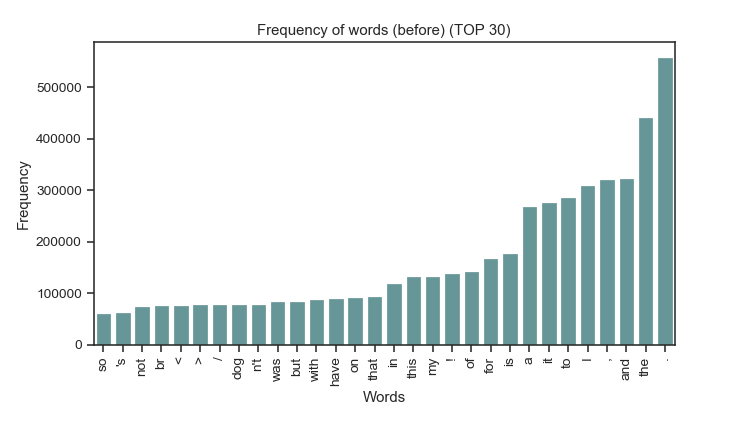

In [225]:
# Create a plot
plt.figure()
sns.barplot(x=list(frequency_before_sorted.keys())[-30:], y=list(frequency_before_sorted.values())[-30:], color='cadetblue')
plt.xticks(rotation=90)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Frequency of words (before) (TOP 30)')
plt.subplots_adjust(left=0.125, right=0.90, bottom=0.2, top=0.90)
plt.show()

There are many words that would not be useful to the model. I'm cleaning up the words.

In [226]:
# How many unique words?
before_word_number = len(set(token for review in tokens_list for token in review))
before_word_number

215207

In [227]:
# lower case
tokens_lower_list = [[token.lower() for token in review] for review in tokens_list]
tokens_lower_list

[['very',
  'soft',
  'warm',
  'material',
  '.',
  'very',
  'large',
  'for',
  'a',
  '3',
  'pounds',
  'dog',
  '.',
  'good',
  'lenght',
  'but',
  'to',
  'large',
  '.',
  'it',
  'fits',
  'my',
  'other',
  'dog',
  'maltesse',
  '-',
  '9.5',
  'pounds',
  '.',
  'it',
  'tooks',
  'very',
  'long',
  'time',
  'to',
  'arrive',
  '...',
  '.',
  'almost',
  'a',
  'month',
  '.',
  'one',
  'button',
  'came',
  'out',
  'alreadyordered',
  'an',
  'xs',
  'and',
  'got',
  'a',
  'small',
  '.',
  'so',
  'obviously',
  'it',
  'is',
  'too',
  'big',
  '.',
  'very',
  'cute',
  'though',
  '.',
  'disappointed.best',
  'coat',
  'a',
  'dog',
  'can',
  'have',
  '.',
  'very',
  'well',
  'made'],
 ['great',
  'value',
  'bulk',
  'pack',
  ',',
  'they',
  'fit',
  'inside',
  'most',
  'standard',
  'cage',
  'doors',
  '...',
  '.i',
  'needed',
  'this',
  'many',
  'because',
  'i',
  'have',
  'a',
  'lot',
  'of',
  'cages.100',
  '%',
  'satisfied.fits',
  'fi

In [229]:
# How many words were removed?
lower_word_number = len(set(token for review in tokens_lower_list for token in review))
before_word_number - lower_word_number

32021

### 2.8. Retaining only alphabets 

In [230]:
# Retain alphabetic words
tokens_alpha_list = [[token for token in review if token.isalpha()] for review in tokens_lower_list]
tokens_alpha_list

[['very',
  'soft',
  'warm',
  'material',
  'very',
  'large',
  'for',
  'a',
  'pounds',
  'dog',
  'good',
  'lenght',
  'but',
  'to',
  'large',
  'it',
  'fits',
  'my',
  'other',
  'dog',
  'maltesse',
  'pounds',
  'it',
  'tooks',
  'very',
  'long',
  'time',
  'to',
  'arrive',
  'almost',
  'a',
  'month',
  'one',
  'button',
  'came',
  'out',
  'alreadyordered',
  'an',
  'xs',
  'and',
  'got',
  'a',
  'small',
  'so',
  'obviously',
  'it',
  'is',
  'too',
  'big',
  'very',
  'cute',
  'though',
  'coat',
  'a',
  'dog',
  'can',
  'have',
  'very',
  'well',
  'made'],
 ['great',
  'value',
  'bulk',
  'pack',
  'they',
  'fit',
  'inside',
  'most',
  'standard',
  'cage',
  'doors',
  'needed',
  'this',
  'many',
  'because',
  'i',
  'have',
  'a',
  'lot',
  'of',
  'fine',
  'and',
  'works',
  'great'],
 ['after',
  'losing',
  'several',
  'collars',
  'during',
  'her',
  'outdoor',
  'forays',
  'our',
  'cat',
  'frences',
  'ca',
  'lose',
  'this',


In [231]:
# How many words were removed?
alph_word_number = len(set(token for review in tokens_alpha_list for token in review))
lower_word_number - alph_word_number

104487

### 2.9. Removing stop words

In [233]:
# Remove all stop words
cached_stop_words = stopwords.words('english')
tokens_nostop_list = [[token for token in review if token not in cached_stop_words] for review in tokens_alpha_list]
tokens_nostop_list

[['soft',
  'warm',
  'material',
  'large',
  'pounds',
  'dog',
  'good',
  'lenght',
  'large',
  'fits',
  'dog',
  'maltesse',
  'pounds',
  'tooks',
  'long',
  'time',
  'arrive',
  'almost',
  'month',
  'one',
  'button',
  'came',
  'alreadyordered',
  'xs',
  'got',
  'small',
  'obviously',
  'big',
  'cute',
  'though',
  'coat',
  'dog',
  'well',
  'made'],
 ['great',
  'value',
  'bulk',
  'pack',
  'fit',
  'inside',
  'standard',
  'cage',
  'doors',
  'needed',
  'many',
  'lot',
  'fine',
  'works',
  'great'],
 ['losing',
  'several',
  'collars',
  'outdoor',
  'forays',
  'cat',
  'frences',
  'ca',
  'lose',
  'collar',
  'soft',
  'perfect',
  'cats',
  'velcro',
  'clksure',
  'makes',
  'adjustable',
  'kitty',
  'necks',
  'elasticity',
  'ensures',
  'however',
  'slip',
  'head',
  'caught',
  'something',
  'criticism',
  'end',
  'collar',
  'extended',
  'bit',
  'far',
  'making',
  'flop',
  'curl',
  'may',
  'annoyed',
  'pickly',
  'girl',
  'well'

In [234]:
# How many words were removed?
nostop_word_number = len(set(token for review in tokens_nostop_list for token in review))
alph_word_number - nostop_word_number

148

In [235]:
# Show the number of unique words
nostop_word_number

78551

### 2.10. Stemming

In [236]:
# Stemming by Snowball stemmer
snowball = SnowballStemmer(language='english')

tokens_stem_list = [[snowball.stem(token) for token in review] for review in tokens_nostop_list]
tokens_stem_list

[['soft',
  'warm',
  'materi',
  'larg',
  'pound',
  'dog',
  'good',
  'lenght',
  'larg',
  'fit',
  'dog',
  'maltess',
  'pound',
  'took',
  'long',
  'time',
  'arriv',
  'almost',
  'month',
  'one',
  'button',
  'came',
  'alreadyord',
  'xs',
  'got',
  'small',
  'obvious',
  'big',
  'cute',
  'though',
  'coat',
  'dog',
  'well',
  'made'],
 ['great',
  'valu',
  'bulk',
  'pack',
  'fit',
  'insid',
  'standard',
  'cage',
  'door',
  'need',
  'mani',
  'lot',
  'fine',
  'work',
  'great'],
 ['lose',
  'sever',
  'collar',
  'outdoor',
  'foray',
  'cat',
  'frenc',
  'ca',
  'lose',
  'collar',
  'soft',
  'perfect',
  'cat',
  'velcro',
  'clksure',
  'make',
  'adjust',
  'kitti',
  'neck',
  'elast',
  'ensur',
  'howev',
  'slip',
  'head',
  'caught',
  'someth',
  'critic',
  'end',
  'collar',
  'extend',
  'bit',
  'far',
  'make',
  'flop',
  'curl',
  'may',
  'annoy',
  'pick',
  'girl',
  'well',
  'use',
  'scratch',
  'trim',
  'negat',
  'import',
  '

In [237]:
# How many words were removed?
stem_word_number = len(set(token for review in tokens_stem_list for token in review))
nostop_word_number - stem_word_number

19644

 Removed 19644 words

In [238]:
# Lemmatization to tokens_stem_list
lem = nltk.WordNetLemmatizer()

tokens_lem_list = [[lem.lemmatize(token) for token in review] for review in tokens_stem_list]
tokens_lem_list

[['soft',
  'warm',
  'materi',
  'larg',
  'pound',
  'dog',
  'good',
  'lenght',
  'larg',
  'fit',
  'dog',
  'maltess',
  'pound',
  'took',
  'long',
  'time',
  'arriv',
  'almost',
  'month',
  'one',
  'button',
  'came',
  'alreadyord',
  'x',
  'got',
  'small',
  'obvious',
  'big',
  'cute',
  'though',
  'coat',
  'dog',
  'well',
  'made'],
 ['great',
  'valu',
  'bulk',
  'pack',
  'fit',
  'insid',
  'standard',
  'cage',
  'door',
  'need',
  'mani',
  'lot',
  'fine',
  'work',
  'great'],
 ['lose',
  'sever',
  'collar',
  'outdoor',
  'foray',
  'cat',
  'frenc',
  'ca',
  'lose',
  'collar',
  'soft',
  'perfect',
  'cat',
  'velcro',
  'clksure',
  'make',
  'adjust',
  'kitti',
  'neck',
  'elast',
  'ensur',
  'howev',
  'slip',
  'head',
  'caught',
  'someth',
  'critic',
  'end',
  'collar',
  'extend',
  'bit',
  'far',
  'make',
  'flop',
  'curl',
  'may',
  'annoy',
  'pick',
  'girl',
  'well',
  'use',
  'scratch',
  'trim',
  'negat',
  'import',
  'e

In [239]:
# How many words were removed?
stem_lem_word_number = len(set(token for review in tokens_lem_list for token in review))
stem_word_number - stem_lem_word_number

241

Reduced 241 words

In [240]:
# Show the number of unique words
stem_lem_word_number

58666

### 2.11. Retaining only nouns

In [241]:
# Show POS
tag_list = [nltk.pos_tag(review) for review in tokens_stem_list]
tag_list

[[('soft', 'JJ'),
  ('warm', 'NN'),
  ('materi', 'NN'),
  ('larg', 'NN'),
  ('pound', 'NN'),
  ('dog', 'RB'),
  ('good', 'JJ'),
  ('lenght', 'NN'),
  ('larg', 'NN'),
  ('fit', 'NN'),
  ('dog', 'NN'),
  ('maltess', 'NN'),
  ('pound', 'NN'),
  ('took', 'VBD'),
  ('long', 'JJ'),
  ('time', 'NN'),
  ('arriv', 'VBZ'),
  ('almost', 'RB'),
  ('month', 'NN'),
  ('one', 'CD'),
  ('button', 'NN'),
  ('came', 'VBD'),
  ('alreadyord', 'JJ'),
  ('xs', 'NNP'),
  ('got', 'VBD'),
  ('small', 'JJ'),
  ('obvious', 'JJ'),
  ('big', 'JJ'),
  ('cute', 'NN'),
  ('though', 'IN'),
  ('coat', 'NN'),
  ('dog', 'NN'),
  ('well', 'RB'),
  ('made', 'VBD')],
 [('great', 'JJ'),
  ('valu', 'NN'),
  ('bulk', 'NN'),
  ('pack', 'NN'),
  ('fit', 'NN'),
  ('insid', 'JJ'),
  ('standard', 'JJ'),
  ('cage', 'NN'),
  ('door', 'NN'),
  ('need', 'VBP'),
  ('mani', 'NN'),
  ('lot', 'NN'),
  ('fine', 'JJ'),
  ('work', 'NN'),
  ('great', 'JJ')],
 [('lose', 'VB'),
  ('sever', 'NN'),
  ('collar', 'NN'),
  ('outdoor', 'NN'),
  ('fora

In [242]:
# Retain only nouns
token_noun_list = [[token[0] for token in review if token[1] == ('NN' or 'NNP' or 'NNPS' or 'VBG')] for review in tag_list]
token_noun_list

[['warm',
  'materi',
  'larg',
  'pound',
  'lenght',
  'larg',
  'fit',
  'dog',
  'maltess',
  'pound',
  'time',
  'month',
  'button',
  'cute',
  'coat',
  'dog'],
 ['valu', 'bulk', 'pack', 'fit', 'cage', 'door', 'mani', 'lot', 'work'],
 ['sever',
  'collar',
  'outdoor',
  'foray',
  'cat',
  'frenc',
  'cat',
  'velcro',
  'clksure',
  'ensur',
  'howev',
  'head',
  'end',
  'collar',
  'bit',
  'curl',
  'pick',
  'girl',
  'import',
  'look',
  'easili',
  'adjust',
  'afford',
  'beasti',
  'band',
  'collar',
  'buy',
  'work',
  'cat',
  'cat',
  'cat',
  'stay',
  'collar'],
 ['work',
  'collar',
  'petsaf',
  'wireless',
  'fenc',
  'happi',
  'batteri',
  'life',
  'collar',
  'collar',
  'charg',
  'week',
  'provid',
  'ampl',
  'signal',
  'strength',
  'consist',
  'area',
  'happi',
  'month',
  'lot',
  'money',
  'money',
  'retriev',
  'charg',
  'area',
  'let',
  'need',
  'exercis',
  'fear',
  'perimet',
  'chase',
  'cat',
  'weight',
  'gold'],
 ['latch',

In [243]:
# How many words were removed?
noun_word_number = len(set(token for review in token_noun_list for token in review))
stem_word_number - noun_word_number

16402

In [244]:
# Show the number of unique words
noun_word_number

42505

### 2.12. Removing words appearing only once or twice

Words appearing only a few are not useful to know the relationship with other products. I'm removing the words.

In [245]:
# Count the number of each word in the documents
# Put all words in a list
words_list_noun = [token for review in token_noun_list for token in review]

frequency_noun = nltk.FreqDist(words_list_noun)

In [246]:
# Collect words appearing equal to or less than 2
words_few = [k for k,v in frequency_noun.items() if v <= 2]

# How many words appearing equal to or less than 2?
print(len(words_few))

# Show the words?
words_few

27968


['maltess',
 'frenc',
 'clksure',
 'brig',
 'carereadi',
 'bestproduct',
 'describedwhil',
 'poochon',
 'forterr',
 'complaintslast',
 'costalway',
 'anyonework',
 'joybiessel',
 'lovelyunhappi',
 'recommendedaafco',
 'adequaci',
 'trin',
 'snowthey',
 'nhl',
 'holograph',
 'disappointedwhen',
 'bugi',
 'troller',
 'solveit',
 'giaratr',
 'wiemaran',
 'fita',
 'usethought',
 'buywhen',
 'bari',
 'knocker',
 'safewel',
 'functionalveri',
 'pertsmart',
 'havin',
 'fishreal',
 'nutrtion',
 'cansne',
 'ottoson',
 'shei',
 'blakc',
 'critiquemi',
 'shweeni',
 'bonegreat',
 'velcrowoulf',
 'expectedless',
 'supposeveri',
 'retrac',
 'anymorelov',
 'chump',
 'bowi',
 'gomez',
 'finnley',
 'cannivor',
 'rollin',
 'waterr',
 'statedcatit',
 'lhassa',
 'refiger',
 'favoritegood',
 'treatwoof',
 'addictedmi',
 'scentfabul',
 'penetrationthi',
 'designwork',
 'icestorm',
 'greatfluk',
 'champoo',
 'remin',
 'bloodstream',
 'longum',
 'wouldwork',
 'foodveri',
 'badwast',
 'woodsit',
 'conveniencew

In [247]:
# Remove words appearing equal to or less than 2
token_more2_list = [[token for token in review if token not in words_few] for review in  token_noun_list]

In [248]:
# Show the number of unique words
len(set(token for review in token_more2_list for token in review))

14537

In [249]:
# Count the number of each word 
words_list_more2 = [token for review in token_more2_list for token in review]
frequency_more2 = nltk.FreqDist(words_list_more2)

# Sort the dictionary
frequency_more2_sorted = dict(sorted(frequency_more2.items(), key=lambda w: w[1]))
frequency_more2_sorted

{'foray': 3,
 'cheepli': 3,
 'successor': 3,
 'hv': 3,
 'tru': 3,
 'purposegreat': 3,
 'doin': 3,
 'bms': 3,
 'walkabout': 3,
 'gato': 3,
 'gloppi': 3,
 'wonderfulth': 3,
 'moot': 3,
 'hipster': 3,
 'underlay': 3,
 'problemsgood': 3,
 'etailz': 3,
 'alopecia': 3,
 'jess': 3,
 'toysgreat': 3,
 'alan': 3,
 'sturdywork': 3,
 'galloni': 3,
 'chucker': 3,
 'yardwork': 3,
 'thw': 3,
 'muchlov': 3,
 'counterproduct': 3,
 'dismount': 3,
 'bix': 3,
 'caffein': 3,
 'iwil': 3,
 'themitem': 3,
 'clowder': 3,
 'congreg': 3,
 'lycra': 3,
 'flimsili': 3,
 'birdsthi': 3,
 'hygromet': 3,
 'pointier': 3,
 'reviewit': 3,
 'retin': 3,
 'atrophi': 3,
 'fatcat': 3,
 'scorn': 3,
 'doug': 3,
 'fiji': 3,
 'josi': 3,
 'thre': 3,
 'itus': 3,
 'neighbour': 3,
 'aquariumwork': 3,
 'fetcher': 3,
 'fidobiot': 3,
 'furnatur': 3,
 'rp': 3,
 'haley': 3,
 'dealthi': 3,
 'sacramento': 3,
 'sesam': 3,
 'sould': 3,
 'popi': 3,
 'bebe': 3,
 'miki': 3,
 'argentin': 3,
 'wold': 3,
 'woofi': 3,
 'handbook': 3,
 'taser': 3,
 's

<IPython.core.display.Javascript object>


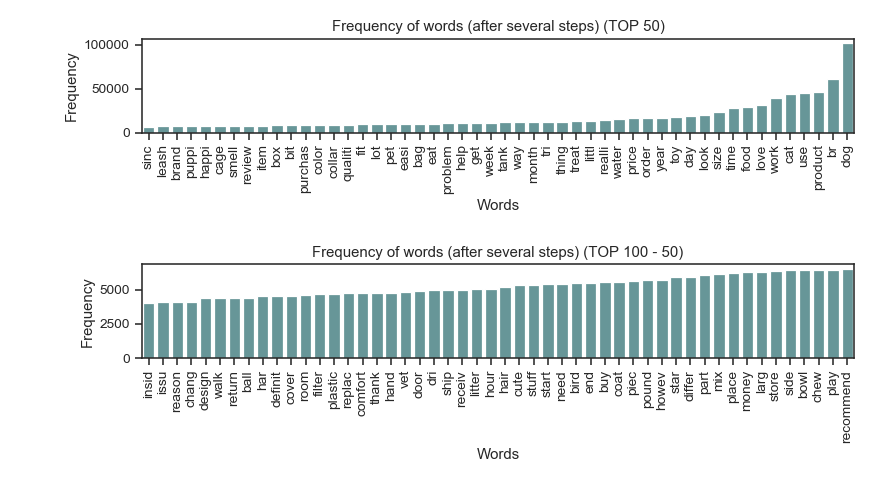

In [255]:
# Create a plot
plt.figure()
plt.subplot(2,1,1)
sns.barplot(x=list(frequency_more2_sorted.keys())[-50:], y=list(frequency_more2_sorted.values())[-50:], color='cadetblue')
plt.xticks(rotation=90)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Frequency of words (after several steps) (TOP 50)')

plt.subplot(2,1,2)
sns.barplot(x=list(frequency_more2_sorted.keys())[-100:-50], y=list(frequency_more2_sorted.values())[-100:-50], color='cadetblue')
plt.xticks(rotation=90)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Frequency of words (after several steps) (TOP 100 - 50)')

plt.tight_layout()
plt.show()

Some words on this chart would not be usable.  I'm removing the words by hand.

In [259]:
# Collect words that would not be useful to categolize products from TOP 100 words
removed_words = ['br', 'product', 'work', 'love', 'time', 'year', 'order', 'price', 'realli', 'littl', 'thing', 'tri', 'get',
                  'problem', 'lot', 'purchas', 'bit', 'review', 'happi', 'recommend', 'store', 'money', 'differ', 'star',
                 'howev', 'buy', 'end', 'need', 'start', 'cute', 'receiv', 'ship', 'thank', 'replac', 'definit', 'return',
                 'chang', 'reason', 'issu']

# Remove them from token_more2_list
token_removed_list = [[token for token in review if token not in removed_words] for review in  token_more2_list]

In [260]:
# Count the number of each word 
words_list_after = [token for review in token_removed_list for token in review]
frequency_after = nltk.FreqDist(words_list_after)

# Sort the dictionary
frequency_after_sorted = dict(sorted(frequency_after.items(), key=lambda w: w[1]))
frequency_after_sorted

{'foray': 3,
 'cheepli': 3,
 'successor': 3,
 'hv': 3,
 'tru': 3,
 'purposegreat': 3,
 'doin': 3,
 'bms': 3,
 'walkabout': 3,
 'gato': 3,
 'gloppi': 3,
 'wonderfulth': 3,
 'moot': 3,
 'hipster': 3,
 'underlay': 3,
 'problemsgood': 3,
 'etailz': 3,
 'alopecia': 3,
 'jess': 3,
 'toysgreat': 3,
 'alan': 3,
 'sturdywork': 3,
 'galloni': 3,
 'chucker': 3,
 'yardwork': 3,
 'thw': 3,
 'muchlov': 3,
 'counterproduct': 3,
 'dismount': 3,
 'bix': 3,
 'caffein': 3,
 'iwil': 3,
 'themitem': 3,
 'clowder': 3,
 'congreg': 3,
 'lycra': 3,
 'flimsili': 3,
 'birdsthi': 3,
 'hygromet': 3,
 'pointier': 3,
 'reviewit': 3,
 'retin': 3,
 'atrophi': 3,
 'fatcat': 3,
 'scorn': 3,
 'doug': 3,
 'fiji': 3,
 'josi': 3,
 'thre': 3,
 'itus': 3,
 'neighbour': 3,
 'aquariumwork': 3,
 'fetcher': 3,
 'fidobiot': 3,
 'furnatur': 3,
 'rp': 3,
 'haley': 3,
 'dealthi': 3,
 'sacramento': 3,
 'sesam': 3,
 'sould': 3,
 'popi': 3,
 'bebe': 3,
 'miki': 3,
 'argentin': 3,
 'wold': 3,
 'woofi': 3,
 'handbook': 3,
 'taser': 3,
 's

<IPython.core.display.Javascript object>


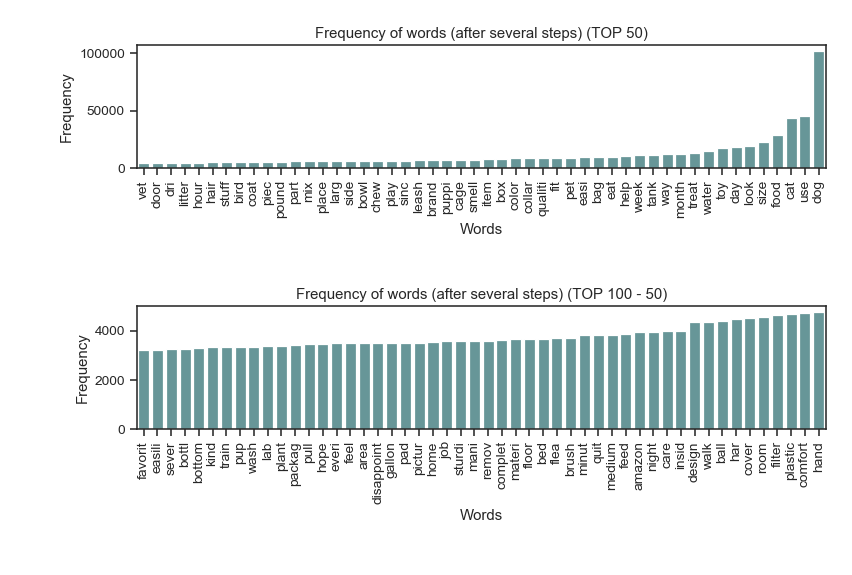

In [261]:
# Create a plot
plt.figure()
plt.subplot(2,1,1)
sns.barplot(x=list(frequency_after_sorted.keys())[-50:], y=list(frequency_after_sorted.values())[-50:], color='cadetblue')
plt.xticks(rotation=90)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Frequency of words (after several steps) (TOP 50)')

plt.subplot(2,1,2)
sns.barplot(x=list(frequency_after_sorted.keys())[-100:-50], y=list(frequency_after_sorted.values())[-100:-50],
            color='cadetblue')
plt.xticks(rotation=90)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Frequency of words (after several steps) (TOP 100 - 50)')

plt.tight_layout()
plt.show()

In [263]:
# Check the number of unique words
len(set(token for review in token_removed_list for token in review))

14498

In [264]:
# Confirm the number of products
len(token_removed_list)

71729

This is not changed.

In [268]:
# Check whether there is a product without any token
empty = [i for i in range(len(token_removed_list)) if token_removed_list[i] == []]
len(empty)

272

272 products don't have any token. I'm removing the products from the model.

In [273]:
# Get product_ids without any token 
notoken_product_id = [id_name.index[i] for i in empty]
notoken_product_id

[881520,
 11853313,
 21381186,
 22667329,
 26623460,
 35688330,
 36157568,
 36993144,
 38371875,
 44757587,
 44917747,
 45138981,
 51131487,
 59665640,
 64461215,
 68458564,
 77037522,
 80049694,
 80698217,
 81191514,
 84670009,
 85928253,
 94865098,
 106057039,
 106185464,
 107856053,
 109618309,
 114231590,
 125739790,
 130914289,
 149104548,
 149236412,
 154112323,
 160867753,
 178936416,
 179288044,
 179731738,
 182167697,
 188007339,
 191107214,
 191553447,
 194131593,
 195210681,
 198014939,
 198862585,
 202135832,
 202496397,
 205693710,
 210609241,
 210819806,
 219930165,
 221230273,
 221468001,
 225318031,
 227463962,
 228965377,
 229848368,
 231938797,
 234005261,
 239613124,
 243949633,
 246258111,
 254069182,
 259558716,
 261957242,
 265748707,
 273675180,
 283181248,
 288180208,
 297035134,
 299723062,
 301639124,
 302914858,
 304994924,
 307398697,
 311436027,
 313637230,
 319964082,
 325282891,
 328330064,
 332987980,
 333613397,
 335651001,
 338150874,
 345486670,
 3457

In [373]:
# Extract several examples of no token products to check them
df_no_token = df[df['product_id'] == 881520].append(df[df['product_id'] == 11853313]).append(df[df['product_id'] == 21381186])

# Change the setting to be able to see all words
pd.set_option("display.max_colwidth", 100)

# Show the product information
df_no_token

,product_id,product_title,review_body
94353,881520,abcGoodefg 3' 2-Wire FBI Style Headset Earpiece Mic Surveillance Kit For Motorola Radio HT750 HT...,Works great!
366489,881520,abcGoodefg 3' 2-Wire FBI Style Headset Earpiece Mic Surveillance Kit For Motorola Radio HT750 HT...,Works
217202,11853313,Pure-Ness Zeolite Air Filter,Makes a noticeable difference
1025606,11853313,Pure-Ness Zeolite Air Filter,Worked great.
714018,21381186,Pet Qwerks S39 Scottish Terrier Dog Sticker,"Just as I expected, shipped very promptly. Thank you."
1408317,21381186,Pet Qwerks S39 Scottish Terrier Dog Sticker,I got this just because it has scotties on it . I have 3 scotties and they are a great dog..


These products have only two reviews. Some reviews are short, and the reviews don't have useful information to categorize them.

In [284]:
# Remove empty lists from token_removed_list
token_noempty_list = [tokens for tokens in token_removed_list if tokens != []]
len(token_noempty_list)

71457

71729 - 272 = 71457: successfully removed

In [285]:
# Make a new id-name list
new_id_name = id_name.drop(notoken_product_id)
new_id_name

,product_title
product_id,
3270,PETSOO Puppy Dog Pets Cute Winter Clothing Coa...
8072,YML Lot of 12 Clear Plastic Cup for Breeding C...
17464,"Beastie Bands ZEBRA Cat Collar, StripesBeastie..."
19343,PetSafe PIF00-12917 Stay & Play Wireless Fence...
23478,YML Double Door Dog Kennel Cage with Plastic T...
...,...
999930798,"S3 Granules For Dogs, 960 GramsS3 Granules For..."
999944581,"KONG ZoomGroom, Dog Grooming Brush, SmallKONG ..."
999961811,Tradewinds 8785 Canine Tapeworm Tablets - 5 x ...


Table4. Product id - name list (for the model)

In [286]:
# Create a table of the removed product for later
notoken_products = id_name[~id_name.index.isin(new_id_name.index)]
notoken_products

,product_title
product_id,
881520,abcGoodefg 3' 2-Wire FBI Style Headset Earpiec...
11853313,Pure-Ness Zeolite Air FilterPure-Ness Zeolite ...
21381186,Pet Qwerks S39 Scottish Terrier Dog StickerPet...
22667329,KORDON #30021 Pond Amquel Plus-Pond Water Con...
26623460,Zeagoo PU Comfortable Boots Waterproof Shoes F...
...,...
978496896,X-Large Clear Frag Rack For Corals and Frag Pl...
982486744,Current Usa ACU02035 SunPaq SmartPaq 10000k/46...
989308376,"Deep Blue Professional ADB12028 Fish Net, 8 by..."


Table5. No token products list

## 3. Exploratory Data Analysis

3.1. The number of products relating to each animal  
3.2. The number of products relating to each supply

### 3.1. The number of products relating to each animal

Count the rough numbers of products relating to a specific animal.

In [288]:
# Define a function returning the number of products having a specific word as a token
def count_word(word):
    count = 0
    for product in token_noempty_list:
        if word in product:
            count += 1
    return count

In [306]:
# Count products having 'dog', 'puppi' or 'doggi' as a token
count_dog = count_word('dog')
count_puppi = count_word('puppi')
count_doggi = count_word('doggi')
count_dogs = count_dog + count_puppi + count_doggi
print('Dog:', count_dogs)

# Count products having 'cat', 'kitti', 'kitt' or 'kitten' as a token
count_cat = count_word('cat')
count_kitti = count_word('kitti')
count_kitt = count_word('kitt')
count_kitten = count_word('kitten')
count_cats = count_cat + count_kitti + count_kitt + count_kitten
print('Cat:', count_cats)

# Count products having 'bird' as a token
count_bird = count_word('bird')
print('Bird:', count_bird)

# Count products having 'fish' as a token
count_fish = count_word('fish')
print('Fish:', count_fish)

# Count products having 'rabit' as a token
count_rabit = count_word('rabit')
print('Rabit:', count_rabit)

Dog: 42760
Cat: 13638
Bird: 2536
Fish: 1605
Rabit: 3


<IPython.core.display.Javascript object>


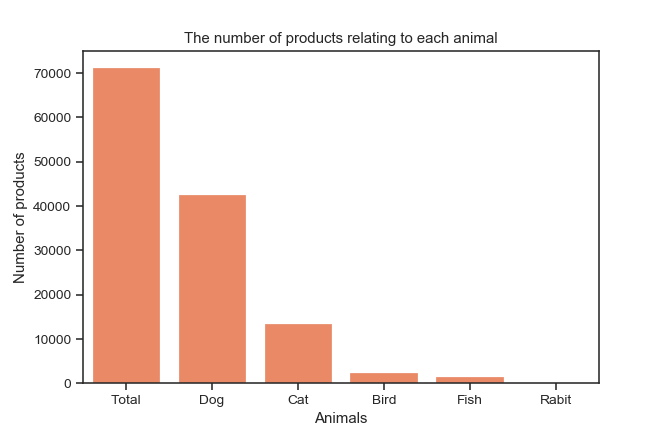

In [430]:
# Draw a bar plot
plt.figure()
sns.barplot(x=['Total', 'Dog', 'Cat', 'Bird', 'Fish', 'Rabit'],
            y=[len(token_noempty_list), count_dogs, count_cats, count_bird, count_fish, count_rabit], color='coral')
plt.xlabel('Animals')
plt.ylabel('Number of products')
plt.title('The number of products relating to each animal')
plt.show()

The main products were for dogs or cats.

### 3.2. The number of products relating to each supply

Count the rough numbers of products relating to food, treats, toys, toilet, cages, clothes, or collars.

In [352]:
# Count products having 'food', 'dri' or 'wet' as a token
count_food = count_word('food')
count_dri = count_word('dri')
count_wet = count_word('wet')
count_foods = count_food + count_dri + count_wet
print('Food:', count_foods)

# Count products having 'treat', 'snack', or 'cooki' as a token
count_treat = count_word('treat')
count_snack = count_word('snack')
count_cooki = count_word('cooki')
count_treats = count_treat + count_snack + count_cooki
print('Treat:', count_treats)

# Count products having 'toy', 'tunnel', 'ball', 'rope', or 'stuff' as a token
count_toy = count_word('toy')
count_tunnel = count_word('tunnel')
count_ball = count_word('ball')
count_rope = count_word('rope')
count_stuff = count_word('stuff')
count_toys = count_toy + count_tunnel + count_ball + count_rope + count_stuff
print('Toy:', count_toys)

# Count products having 'litter', or 'pad' as a token
count_litter = count_word('litter')
count_pad = count_word('pad')
count_toilet = count_litter + count_pad
print('Toilet:', count_toilet)

# Count products having 'cage', 'crate', 'carrier', or 'kennel' as a token
count_cage = count_word('cage')
count_crate = count_word('crate')
count_carrier = count_word('carrier')
count_kennel = count_word('kennel')
count_cages = count_cage + count_crate + count_carrier + count_kennel
print('Cage:', count_cages)

# Count products having 'shirt', 'coat', 'sweater', or 'costum' as a token
count_shirt = count_word('shirt')
count_coat = count_word('coat')
count_sweater = count_word('sweater')
count_costum = count_word('costum')
count_clothes = count_shirt + count_coat + count_sweater + count_costum
print('Clothes:', count_clothes)

# Count products having 'collar', or 'leash' as a token
count_collar = count_word('collar')
count_leash = count_word('leash')
count_collar_leash = count_collar + count_leash
print('Collar&Leash:', count_collar_leash)

Food: 13860
Treat: 7245
Toy: 14307
Toilet: 3509
Cage: 4572
Clothes: 5062
Collar&Leash: 7034


<IPython.core.display.Javascript object>


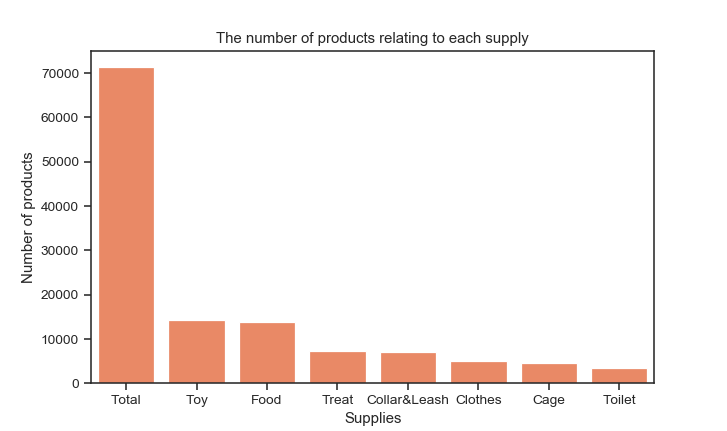

In [429]:
# Draw a bar plot
plt.figure()
sns.barplot(x=['Total', 'Toy', 'Food', 'Treat', 'Collar&Leash', 'Clothes', 'Cage', 'Toilet'],
            y=[len(token_noempty_list), count_toys, count_foods, count_treats, count_collar_leash, count_clothes,
               count_cages, count_toilet], color='coral')
plt.xlabel('Supplies')
plt.ylabel('Number of products')
plt.title('The number of products relating to each supply')
plt.show()

The products are spread in several supply categories.

### 3.3. The rough relationship between an animal kind and supply kind

I pick up a dog and cat as a animal kind, and a toy and food as a supply kind. Check the relationship between them.

In [394]:
# Define a function making coordinates
def make_coordinate(list_name, word1, word2, num):
    for i in range(len(token_noempty_list)):
        product = token_noempty_list[i]
        if word1 in product:
            list_name[i][num] += 1
        if word2 in product:
            list_name[i][num] += 2
    return list_name

In [395]:
# Make coorfinates showing the presence of words; dog and/or cat,and toy and/or food
# [1, 0] means the product has 'dog' and doesn't have 'cat', 'toy', or 'food' as the tokens
# [3, 2] means the product has 'dog', 'cat', and 'food' as the tokens

# Make an initial list
animal_supply = [[0, 0] for i in range(len(token_noempty_list))]

# Make coorfinates
animal_supply = make_coordinate(animal_supply, 'dog', 'cat', 0)
animal_supply = make_coordinate(animal_supply, 'toy', 'food', 1)
animal_supply

[[1, 0],
 [0, 0],
 [2, 0],
 [2, 0],
 [1, 0],
 [0, 0],
 [1, 0],
 [1, 0],
 [3, 0],
 [0, 0],
 [1, 1],
 [0, 0],
 [0, 0],
 [1, 0],
 [1, 0],
 [1, 0],
 [1, 2],
 [1, 2],
 [1, 0],
 [1, 0],
 [1, 0],
 [1, 0],
 [1, 0],
 [2, 0],
 [0, 0],
 [0, 0],
 [1, 0],
 [0, 0],
 [1, 0],
 [0, 1],
 [1, 0],
 [0, 0],
 [0, 0],
 [1, 0],
 [0, 0],
 [2, 0],
 [0, 0],
 [1, 0],
 [3, 2],
 [0, 0],
 [2, 0],
 [0, 1],
 [2, 0],
 [0, 0],
 [1, 1],
 [2, 0],
 [0, 0],
 [0, 0],
 [2, 1],
 [2, 0],
 [0, 0],
 [0, 0],
 [1, 0],
 [1, 2],
 [1, 0],
 [3, 0],
 [3, 0],
 [2, 2],
 [1, 0],
 [1, 0],
 [3, 2],
 [1, 0],
 [1, 1],
 [3, 0],
 [0, 1],
 [1, 2],
 [0, 0],
 [2, 0],
 [0, 2],
 [2, 0],
 [0, 1],
 [1, 0],
 [1, 0],
 [0, 0],
 [1, 0],
 [0, 0],
 [0, 1],
 [0, 0],
 [2, 0],
 [1, 0],
 [2, 0],
 [0, 2],
 [1, 0],
 [0, 2],
 [0, 0],
 [0, 1],
 [0, 2],
 [0, 0],
 [0, 1],
 [1, 0],
 [0, 0],
 [1, 0],
 [2, 2],
 [0, 0],
 [1, 2],
 [2, 2],
 [1, 0],
 [0, 0],
 [2, 1],
 [1, 0],
 [1, 0],
 [3, 0],
 [1, 0],
 [2, 2],
 [1, 2],
 [0, 0],
 [1, 1],
 [0, 0],
 [1, 1],
 [0, 0],
 [0, 0],
 

<IPython.core.display.Javascript object>


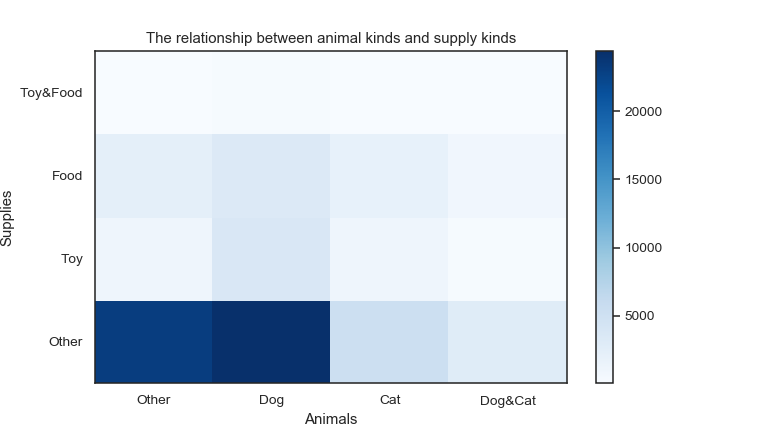

In [425]:
# Make an initial list to draw a pseudocolor plot
mesh_list = [[0,0,0,0], [0,0,0,0],[0,0,0,0],[0,0,0,0]]

# Count the number of products fitting each compartment and make the numpy array
for product in animal_supply:
    mesh_list[product[1]][product[0]] += 1
mesh_arr = np.array(mesh_list)

# Make mesh
u = np.linspace(-1, 1, 5)
v = np.linspace(-1, 1, 5)
X,Y = np.meshgrid(u, v)

# Draw a pseudocolor plot
plt.figure()
plt.pcolor(mesh_arr, cmap='Blues')
plt.colorbar()
plt.xticks(ticks=[0, 0.5, 1, 1.5, 2, 2.5, 3, 3.5, 4], labels=['','Other', '', 'Dog', '', 'Cat', '', 'Dog&Cat', ''])
plt.yticks(ticks=[0, 0.5, 1, 1.5, 2, 2.5, 3, 3.5, 4], labels=['','Other', '', 'Toy', '', 'Food', '', 'Toy&Food', ''])
plt.tick_params(bottom=False, left=False)
plt.xlabel('Animals')
plt.ylabel('Supplies')
plt.title('The relationship between animal kinds and supply kinds')
plt.show()

Food and toys for dogs are the largest two categories on the chart, but many products are in Other. I will categorize them more precisely in the modeling part of this project. 

## 4. Building the model

#### Approach:

4.1. Vectorization with tf-idf  
4.2. Applying k-means model  


### 4.1. Vectorization with tf-idf

In [439]:
# How many unique words?
len(set(token for review in token_noempty_list for token in review))

14498

In [442]:
# Create TfidfVectorizer object with bigrams and trigrams
def dummy_tokened(text):
    return text

vectorizer = TfidfVectorizer(tokenizer=dummy_tokened, lowercase=False, ngram_range=(1, 3))  

# Generate matrix of word vectors
tfidf_matrix = vectorizer.fit_transform(token_noempty_list)

# Get the feature names
feature_names = vectorizer.get_feature_names()

# Show the shape of tfidf_matrix
tfidf_matrix.shape

(71457, 2750672)